In [158]:
#%% LOAD THE LIBRARIES
from sklearn.naive_bayes import GaussianNB
import itertools

from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import StandardScaler

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import InputLayer
from tensorflow.keras.utils import to_categorical

import numpy as np
import pandas as pd
import cv2 as cv

import matplotlib
matplotlib.rcParams['figure.dpi'] = 125
import matplotlib.pyplot as plt
#from importance.imutils import imshow
from sklearn.tree import DecisionTreeClassifier
from tqdm import tqdm
#from skimage.feature import greycomatrix, greycoprops
from skimage.color import rgb2gray
from sklearn.metrics import classification_report, confusion_matrix
import skimage
from sklearn.svm import SVC


from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
import seaborn as sns

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from sklearn.ensemble import RandomForestClassifier

plt.rcParams["figure.dpi"] = 150

from IPython.display import HTML
shell = get_ipython()

def adjust_font_size():
  display(HTML('''<style>
    body {
      font-size: 16px;
    }
  '''))

if adjust_font_size not in shell.events.callbacks['pre_execute']:
  shell.events.register('pre_execute', adjust_font_size)

In [159]:
#%% LOAD THE DATA
X_train= pd.read_csv("ART_features/ART_x_trained_selected_features.csv")
X_train.head(20)

,original_shape_LeastAxisLength,original_shape_MajorAxisLength,original_shape_Maximum2DDiameterRow,original_shape_Maximum2DDiameterSlice,original_shape_Maximum3DDiameter,original_shape_MeshVolume,original_shape_SurfaceArea,original_shape_VoxelVolume,original_firstorder_Energy,original_firstorder_Kurtosis,...,wavelet-LLL_glszm_LargeAreaLowGrayLevelEmphasis,wavelet-LLL_glszm_SizeZoneNonUniformity,wavelet-LLL_glszm_ZoneVariance,wavelet-LLL_gldm_DependenceNonUniformity,wavelet-LLL_gldm_GrayLevelNonUniformity,wavelet-LLL_gldm_HighGrayLevelEmphasis,wavelet-LLL_gldm_LargeDependenceEmphasis,wavelet-LLL_gldm_LargeDependenceHighGrayLevelEmphasis,wavelet-LLL_gldm_LargeDependenceLowGrayLevelEmphasis,wavelet-LLL_ngtdm_Busyness
0,92.472016,214.345379,147.329563,223.617978,223.988839,1.001017e+06,105620.514989,1001340,1.627787e+11,17.060777,...,3.843998e+07,95.023379,9.592501e+08,586950.267110,9.041720e+05,24.528583,651.842777,16176.233838,26.377689,365.604084
1,94.623609,188.147755,169.623112,207.511445,212.513529,1.316649e+06,117300.047718,1316955,1.950735e+11,31.516424,...,7.941458e+06,209.334173,7.177083e+08,89246.384319,6.558572e+05,90.905789,419.245442,38321.524511,4.637433,973.225725
2,119.733780,198.265448,182.280004,227.167339,255.661886,1.581651e+06,127442.354298,1581958,2.683258e+11,35.316145,...,2.071356e+06,280.900969,3.562169e+08,180379.322127,8.562393e+05,175.784006,485.840946,84937.877624,2.792082,255.583351
3,92.485492,228.369590,180.136060,220.238507,261.692568,1.224626e+06,118445.478404,1224965,2.216931e+11,47.537929,...,1.862225e+06,307.191261,3.100019e+08,110830.971407,7.143624e+05,162.891158,460.648388,76424.487780,2.787323,280.993738
4,90.832711,187.720007,159.304739,193.002591,226.121649,1.082497e+06,101265.645738,1082739,2.093912e+11,72.726405,...,5.694237e+05,592.494003,1.650687e+08,148484.857266,6.844825e+05,293.567400,497.371729,145264.360681,1.706473,116.062402
5,115.448894,236.508636,207.963939,268.544224,280.659937,1.765538e+06,151139.994496,1766720,2.705652e+11,15.089224,...,4.631106e+07,161.585485,1.143989e+09,722405.450643,1.338886e+06,23.721848,614.018139,14866.566385,25.775955,1464.875629
6,114.349390,227.070308,204.619158,230.358416,241.524326,1.120611e+06,196511.318860,1124640,1.790728e+11,45.439919,...,9.760983e+06,121.322307,9.751830e+08,650365.929585,1.027957e+06,99.550722,637.020853,63674.098391,6.377377,60.845660
7,93.230145,186.185159,177.087549,201.883630,218.398718,1.059638e+06,104923.301618,1059912,1.831969e+11,25.645173,...,1.448331e+06,281.351655,2.446694e+08,293521.681855,7.697521e+05,168.831248,570.506000,96606.782242,3.375205,125.971219
8,71.717266,206.697310,147.383853,213.190056,227.022025,8.160757e+05,88149.201783,816330,1.205242e+11,10.841825,...,2.790944e+07,87.670982,4.578639e+08,131795.500310,5.247464e+05,18.019796,516.157071,8963.051607,30.508839,1401.433800
9,91.656251,202.491141,155.955122,226.896452,241.182504,1.050584e+06,99053.807221,1050835,1.638729e+11,49.314517,...,1.045796e+07,119.843854,6.688339e+08,582476.958936,9.601016e+05,64.525114,649.143564,41662.957650,10.121446,152.002124


In [160]:
X_train.info 

<bound method DataFrame.info of     original_shape_LeastAxisLength  original_shape_MajorAxisLength  \
0                        92.472016                      214.345379   
1                        94.623609                      188.147755   
2                       119.733780                      198.265448   
3                        92.485492                      228.369590   
4                        90.832711                      187.720007   
..                             ...                             ...   
73                       92.267999                      217.362255   
74                       75.355202                      148.766469   
75                       87.656046                      203.468529   
76                       95.261026                      163.405332   
77                       95.522915                      233.859694   

    original_shape_Maximum2DDiameterRow  \
0                            147.329563   
1                            169.623112  

In [161]:
y_train = pd.read_csv("ART_features/ART_y_train.csv")
y_train.head(10)

,Type
0,0
1,4
2,2
3,1
4,0
5,0
6,3
7,1
8,0
9,1


In [162]:
train_data = X_train.join(y_train)
train_data

,original_shape_LeastAxisLength,original_shape_MajorAxisLength,original_shape_Maximum2DDiameterRow,original_shape_Maximum2DDiameterSlice,original_shape_Maximum3DDiameter,original_shape_MeshVolume,original_shape_SurfaceArea,original_shape_VoxelVolume,original_firstorder_Energy,original_firstorder_Kurtosis,...,wavelet-LLL_glszm_SizeZoneNonUniformity,wavelet-LLL_glszm_ZoneVariance,wavelet-LLL_gldm_DependenceNonUniformity,wavelet-LLL_gldm_GrayLevelNonUniformity,wavelet-LLL_gldm_HighGrayLevelEmphasis,wavelet-LLL_gldm_LargeDependenceEmphasis,wavelet-LLL_gldm_LargeDependenceHighGrayLevelEmphasis,wavelet-LLL_gldm_LargeDependenceLowGrayLevelEmphasis,wavelet-LLL_ngtdm_Busyness,Type
0,92.472016,214.345379,147.329563,223.617978,223.988839,1.001017e+06,105620.514989,1001340,1.627787e+11,17.060777,...,95.023379,9.592501e+08,586950.267110,9.041720e+05,24.528583,651.842777,1.617623e+04,26.377689,365.604084,0
1,94.623609,188.147755,169.623112,207.511445,212.513529,1.316649e+06,117300.047718,1316955,1.950735e+11,31.516424,...,209.334173,7.177083e+08,89246.384319,6.558572e+05,90.905789,419.245442,3.832152e+04,4.637433,973.225725,4
2,119.733780,198.265448,182.280004,227.167339,255.661886,1.581651e+06,127442.354298,1581958,2.683258e+11,35.316145,...,280.900969,3.562169e+08,180379.322127,8.562393e+05,175.784006,485.840946,8.493788e+04,2.792082,255.583351,2
3,92.485492,228.369590,180.136060,220.238507,261.692568,1.224626e+06,118445.478404,1224965,2.216931e+11,47.537929,...,307.191261,3.100019e+08,110830.971407,7.143624e+05,162.891158,460.648388,7.642449e+04,2.787323,280.993738,1
4,90.832711,187.720007,159.304739,193.002591,226.121649,1.082497e+06,101265.645738,1082739,2.093912e+11,72.726405,...,592.494003,1.650687e+08,148484.857266,6.844825e+05,293.567400,497.371729,1.452644e+05,1.706473,116.062402,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
73,92.267999,217.362255,181.747077,235.987288,248.173327,1.280355e+06,127895.264506,1281150,1.976031e+11,51.715046,...,133.269916,1.402472e+09,924506.862561,1.173992e+06,99.116150,671.627483,6.697567e+04,6.740282,38.493433,1
74,75.355202,148.766469,149.723078,202.192977,204.306143,6.981408e+05,82825.386432,698467,1.318896e+11,45.230615,...,479.041355,7.213313e+07,39774.625935,2.930980e+05,265.164651,395.912819,1.054997e+05,1.494919,107.623476,1
75,87.656046,203.468529,151.198545,255.720551,264.854677,1.076845e+06,102841.332296,1077035,1.684420e+11,7891.591390,...,196.861096,4.426879e+08,220884.367363,7.651753e+05,2617.023350,541.807742,1.414065e+06,0.208893,83.851615,4
76,95.261026,163.405332,159.677801,183.447540,199.704782,9.133663e+05,83218.047171,913661,1.700553e+11,61.463651,...,299.946411,1.799199e+08,160702.307706,5.935532e+05,219.475690,524.439860,1.167541e+05,2.361107,116.429020,0


In [163]:
train_data.hist(figsize=(110, 75))

array([[<Axes: title={'center': 'original_shape_LeastAxisLength'}>,
        <Axes: title={'center': 'original_shape_MajorAxisLength'}>,
        <Axes: title={'center': 'original_shape_Maximum2DDiameterRow'}>,
        <Axes: title={'center': 'original_shape_Maximum2DDiameterSlice'}>,
        <Axes: title={'center': 'original_shape_Maximum3DDiameter'}>,
        <Axes: title={'center': 'original_shape_MeshVolume'}>,
        <Axes: title={'center': 'original_shape_SurfaceArea'}>,
        <Axes: title={'center': 'original_shape_VoxelVolume'}>,
        <Axes: title={'center': 'original_firstorder_Energy'}>,
        <Axes: title={'center': 'original_firstorder_Kurtosis'}>,
        <Axes: title={'center': 'original_firstorder_TotalEnergy'}>,
        <Axes: title={'center': 'original_glrlm_GrayLevelNonUniformity'}>],
       [<Axes: title={'center': 'original_glrlm_LongRunEmphasis'}>,
        <Axes: title={'center': 'original_glrlm_LongRunHighGrayLevelEmphasis'}>,
        <Axes: title={'center':

In [164]:
train_data.corr()

,original_shape_LeastAxisLength,original_shape_MajorAxisLength,original_shape_Maximum2DDiameterRow,original_shape_Maximum2DDiameterSlice,original_shape_Maximum3DDiameter,original_shape_MeshVolume,original_shape_SurfaceArea,original_shape_VoxelVolume,original_firstorder_Energy,original_firstorder_Kurtosis,...,wavelet-LLL_glszm_SizeZoneNonUniformity,wavelet-LLL_glszm_ZoneVariance,wavelet-LLL_gldm_DependenceNonUniformity,wavelet-LLL_gldm_GrayLevelNonUniformity,wavelet-LLL_gldm_HighGrayLevelEmphasis,wavelet-LLL_gldm_LargeDependenceEmphasis,wavelet-LLL_gldm_LargeDependenceHighGrayLevelEmphasis,wavelet-LLL_gldm_LargeDependenceLowGrayLevelEmphasis,wavelet-LLL_ngtdm_Busyness,Type
original_shape_LeastAxisLength,1.000000,0.376836,0.378767,0.470186,0.461244,0.680015,0.720369,0.680718,0.678492,-0.018530,...,0.164726,0.130494,0.276940,0.543118,0.011810,0.131734,0.016641,-0.048763,0.020502,0.087390
original_shape_MajorAxisLength,0.376836,1.000000,0.439738,0.803288,0.827924,0.573844,0.709510,0.574350,0.546913,0.026247,...,0.189414,0.110170,0.146563,0.391291,0.058982,0.055994,0.062036,0.022985,0.135104,0.055564
original_shape_Maximum2DDiameterRow,0.378767,0.439738,1.000000,0.310899,0.626929,0.536053,0.678122,0.536753,0.498043,0.002415,...,0.092700,0.143486,0.140650,0.328258,-0.036209,-0.000544,-0.022748,-0.126283,0.261037,0.022281
original_shape_Maximum2DDiameterSlice,0.470186,0.803288,0.310899,1.000000,0.796407,0.603506,0.652581,0.603935,0.564740,0.197436,...,0.230488,0.133778,0.170038,0.423948,0.222615,0.038525,0.223782,-0.031802,-0.039388,0.092153
original_shape_Maximum3DDiameter,0.461244,0.827924,0.626929,0.796407,1.000000,0.662983,0.728652,0.663337,0.623989,0.190329,...,0.121886,0.228516,0.174676,0.439899,0.164209,0.042753,0.174202,0.025087,0.172396,0.090179
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
wavelet-LLL_gldm_LargeDependenceEmphasis,0.131734,0.055994,-0.000544,0.038525,0.042753,0.047017,0.014410,0.046976,-0.101504,-0.014507,...,-0.509998,0.619885,0.900903,0.731176,-0.234601,1.000000,-0.177723,0.498331,-0.317476,0.124341
wavelet-LLL_gldm_LargeDependenceHighGrayLevelEmphasis,0.016641,0.062036,-0.022748,0.223782,0.174202,-0.023131,0.004458,-0.023162,0.044185,0.924708,...,0.294834,-0.237225,-0.216416,-0.129318,0.996168,-0.177723,1.000000,-0.361887,-0.181576,0.235660
wavelet-LLL_gldm_LargeDependenceLowGrayLevelEmphasis,-0.048763,0.022985,-0.126283,-0.031802,0.025087,0.007465,-0.087013,0.007226,-0.163949,-0.146569,...,-0.616051,0.658985,0.500102,0.367754,-0.380784,0.498331,-0.361887,1.000000,0.369288,-0.096057
wavelet-LLL_ngtdm_Busyness,0.020502,0.135104,0.261037,-0.039388,0.172396,0.141499,0.164668,0.141446,0.069942,-0.072156,...,-0.268236,0.024618,-0.264473,-0.170913,-0.179493,-0.317476,-0.181576,0.369288,1.000000,-0.158318


In [165]:
plt.figure(figsize=(110,75))
sns.heatmap(train_data.corr(), annot=True, cmap="YlGnBu")

<Axes: >

In [166]:
X_test = pd.read_csv("ART_features/ART_x_test_selected_features.csv")
y_test = pd.read_csv("ART_features/ART_y_test.csv")



In [167]:
test_data = X_test.join(y_test)
train_data.head()

,original_shape_LeastAxisLength,original_shape_MajorAxisLength,original_shape_Maximum2DDiameterRow,original_shape_Maximum2DDiameterSlice,original_shape_Maximum3DDiameter,original_shape_MeshVolume,original_shape_SurfaceArea,original_shape_VoxelVolume,original_firstorder_Energy,original_firstorder_Kurtosis,...,wavelet-LLL_glszm_SizeZoneNonUniformity,wavelet-LLL_glszm_ZoneVariance,wavelet-LLL_gldm_DependenceNonUniformity,wavelet-LLL_gldm_GrayLevelNonUniformity,wavelet-LLL_gldm_HighGrayLevelEmphasis,wavelet-LLL_gldm_LargeDependenceEmphasis,wavelet-LLL_gldm_LargeDependenceHighGrayLevelEmphasis,wavelet-LLL_gldm_LargeDependenceLowGrayLevelEmphasis,wavelet-LLL_ngtdm_Busyness,Type
0,92.472016,214.345379,147.329563,223.617978,223.988839,1.001017e+06,105620.514989,1001340,1.627787e+11,17.060777,...,95.023379,9.592501e+08,586950.267110,904171.979537,24.528583,651.842777,16176.233838,26.377689,365.604084,0
1,94.623609,188.147755,169.623112,207.511445,212.513529,1.316649e+06,117300.047718,1316955,1.950735e+11,31.516424,...,209.334173,7.177083e+08,89246.384319,655857.201929,90.905789,419.245442,38321.524511,4.637433,973.225725,4
2,119.733780,198.265448,182.280004,227.167339,255.661886,1.581651e+06,127442.354298,1581958,2.683258e+11,35.316145,...,280.900969,3.562169e+08,180379.322127,856239.292604,175.784006,485.840946,84937.877624,2.792082,255.583351,2
3,92.485492,228.369590,180.136060,220.238507,261.692568,1.224626e+06,118445.478404,1224965,2.216931e+11,47.537929,...,307.191261,3.100019e+08,110830.971407,714362.433003,162.891158,460.648388,76424.487780,2.787323,280.993738,1
4,90.832711,187.720007,159.304739,193.002591,226.121649,1.082497e+06,101265.645738,1082739,2.093912e+11,72.726405,...,592.494003,1.650687e+08,148484.857266,684482.517256,293.567400,497.371729,145264.360681,1.706473,116.062402,0


In [168]:
#%% SPLIT INTO TRAINING AND TESTING

X_trn, y_trn = np.array(train_data.drop(['Type'], axis=1)), np.array(train_data['Type'])


X_tst, y_tst= np.array(test_data.drop(['Type'], axis=1)), np.array(test_data['Type'])

scaler = StandardScaler()
scaler.fit(X_trn)
X_trn = scaler.transform(X_trn)

scaler.fit(X_tst)
X_tst = scaler.transform(X_tst)


y_trn_cat, y_tst_cat = to_categorical(y_trn), to_categorical(y_tst)

In [169]:
y_trn_cat

array([[1., 0., 0., 0., 0.],
       [0., 0., 0., 0., 1.],
       [0., 0., 1., 0., 0.],
       [0., 1., 0., 0., 0.],
       [1., 0., 0., 0., 0.],
       [1., 0., 0., 0., 0.],
       [0., 0., 0., 1., 0.],
       [0., 1., 0., 0., 0.],
       [1., 0., 0., 0., 0.],
       [0., 1., 0., 0., 0.],
       [1., 0., 0., 0., 0.],
       [0., 0., 0., 1., 0.],
       [0., 0., 0., 0., 1.],
       [0., 1., 0., 0., 0.],
       [0., 0., 1., 0., 0.],
       [1., 0., 0., 0., 0.],
       [0., 0., 1., 0., 0.],
       [0., 0., 1., 0., 0.],
       [1., 0., 0., 0., 0.],
       [1., 0., 0., 0., 0.],
       [0., 0., 1., 0., 0.],
       [1., 0., 0., 0., 0.],
       [1., 0., 0., 0., 0.],
       [0., 0., 0., 1., 0.],
       [0., 0., 1., 0., 0.],
       [0., 0., 1., 0., 0.],
       [1., 0., 0., 0., 0.],
       [0., 0., 1., 0., 0.],
       [0., 0., 0., 1., 0.],
       [0., 0., 0., 0., 1.],
       [1., 0., 0., 0., 0.],
       [0., 0., 0., 1., 0.],
       [1., 0., 0., 0., 0.],
       [1., 0., 0., 0., 0.],
       [1., 0.

In [170]:
# define the model
# define the model
model = Sequential()
model.add(InputLayer(input_shape=(155,)))
model.add(Dense(310, activation="relu"))
model.add(Dense(620, activation="relu"))
model.add(Dense(930, activation="relu"))
#model.add(Dense(2400, activation="relu"))
#model.add(Dense(4800, activation="relu"))
#model.add(Dense(9600, activation="relu"))
#model.add(Dense(4800, activation="relu"))
#model.add(Dense(2400, activation="relu"))
#model.add(Dense(2000, activation="relu"))
#model.add(Dense(3000, activation="relu"))
#model.add(Dense(4000, activation="relu"))
#model.add(Dense(3000, activation="relu"))
#model.add(Dense(2000, activation="relu"))
#model.add(Dense(1200, activation="relu"))
#model.add(Dense(600, activation="relu"))
#model.add(Dense(300, activation="relu"))
model.add(Dense(620, activation="relu"))
model.add(Dense(310, activation="relu"))
model.add(Dense(155, activation="relu"))
model.add(Dense(5, activation="sigmoid"))

# compile the keras model
model.compile(loss="mse", optimizer="sgd", metrics=["accuracy"])

# show the model info
model.summary()

for layer in model.layers:
    print(layer.name)
    print("Weights", layer.get_weights()[0].shape)
    print(layer.get_weights()[0].flatten())
    print("Bias", layer.get_weights()[1].shape)
    print(layer.get_weights()[1])

Model: "sequential_27"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_212 (Dense)           (None, 310)               48360     
                                                                 
 dense_213 (Dense)           (None, 620)               192820    
                                                                 
 dense_214 (Dense)           (None, 930)               577530    
                                                                 
 dense_215 (Dense)           (None, 620)               577220    
                                                                 
 dense_216 (Dense)           (None, 310)               192510    
                                                                 
 dense_217 (Dense)           (None, 155)               48205     
                                                                 
 dense_218 (Dense)           (None, 5)               

In [171]:
# fit the model to the dataset
history = model.fit(X_trn, y_trn_cat, epochs=300, validation_data=(X_tst, y_tst_cat))
# history = model.fit(X_trn, y_trn_cat, epochs=300, validation_split=0.1)

Epoch 1/300
3/3 [==============================] - 1s 128ms/step - loss: 0.2550 - accuracy: 0.1923 - val_loss: 0.2541 - val_accuracy: 0.1538
Epoch 2/300
3/3 [==============================] - 0s 56ms/step - loss: 0.2528 - accuracy: 0.2051 - val_loss: 0.2520 - val_accuracy: 0.1538
Epoch 3/300
3/3 [==============================] - 0s 56ms/step - loss: 0.2505 - accuracy: 0.2051 - val_loss: 0.2500 - val_accuracy: 0.1538
Epoch 4/300
3/3 [==============================] - 0s 52ms/step - loss: 0.2483 - accuracy: 0.2179 - val_loss: 0.2480 - val_accuracy: 0.1538
Epoch 5/300
3/3 [==============================] - 0s 52ms/step - loss: 0.2461 - accuracy: 0.2308 - val_loss: 0.2461 - val_accuracy: 0.1538
Epoch 6/300
3/3 [==============================] - 0s 56ms/step - loss: 0.2440 - accuracy: 0.2436 - val_loss: 0.2442 - val_accuracy: 0.1538
Epoch 7/300
3/3 [==============================] - 0s 52ms/step - loss: 0.2419 - accuracy: 0.2436 - val_loss: 0.2422 - val_accuracy: 0.1538
Epoch 8/300
3/3 [==

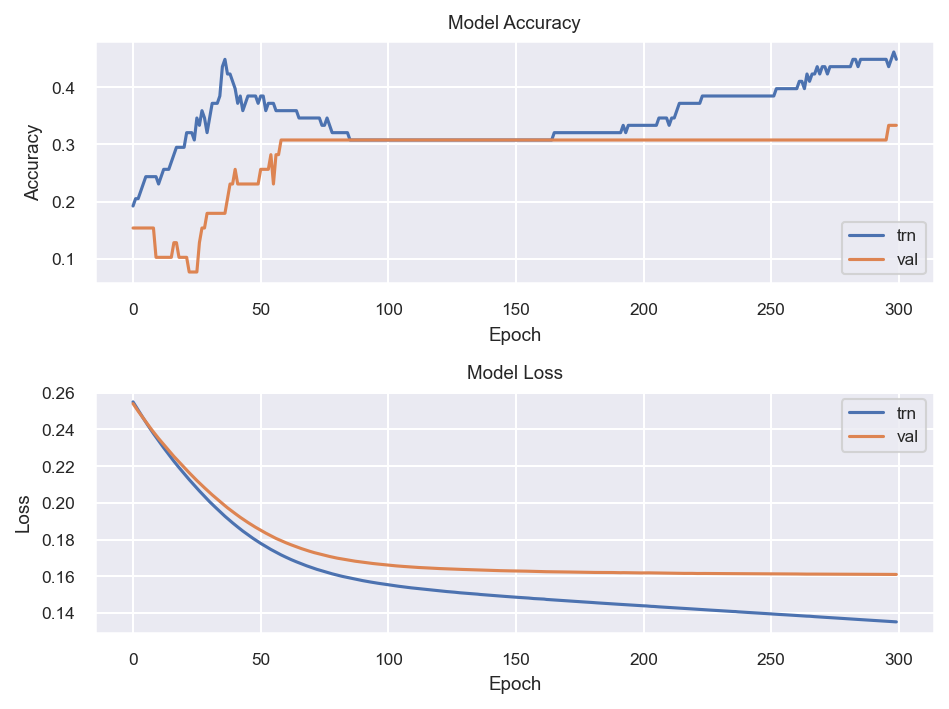

In [172]:
fig = plt.figure()
plt.subplot(2,1,1)
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['trn', 'val'], loc='lower right')

plt.subplot(2,1,2)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['trn', 'val'], loc='upper right')

plt.tight_layout()

Training accuracy:  0.4230769230769231
Testing accuracy:  0.23076923076923078

Classification report (Training):
              precision    recall  f1-score   support

           0       0.59      0.42      0.49        24
           1       0.27      0.29      0.28        14
           2       0.45      0.31      0.37        16
           3       0.35      0.50      0.41        16
           4       0.50      0.75      0.60         8

    accuracy                           0.42        78
   macro avg       0.43      0.45      0.43        78
weighted avg       0.44      0.42      0.42        78


Classification report (Testing):
              precision    recall  f1-score   support

           0       0.40      0.17      0.24        12
           1       0.11      0.25      0.15         4
           2       0.33      0.22      0.27         9
           3       0.25      0.22      0.24         9
           4       0.18      0.40      0.25         5

    accuracy                          

Text(0.5, 36.07499999999998, 'Predicted label')

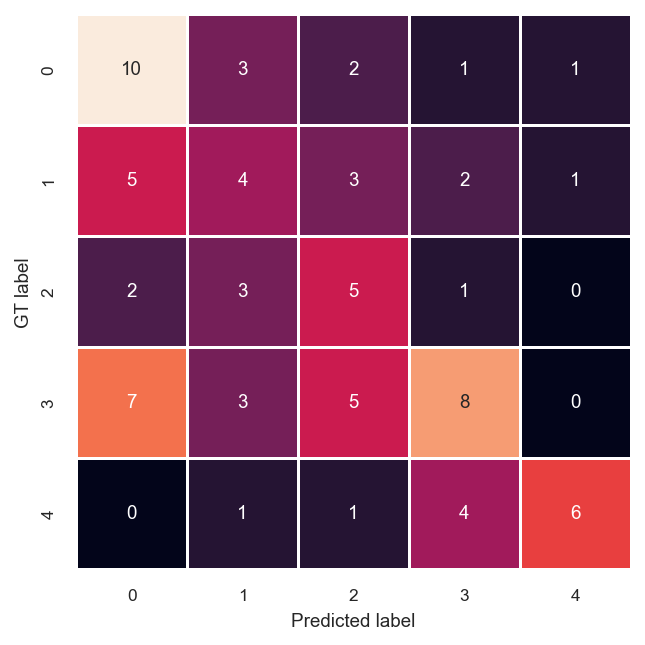

In [59]:
# SVM
model = GaussianNB()
model.fit(X_trn, y_trn)

y_trn_prd = model.predict(X_trn)
print('Training accuracy: ',
  accuracy_score(y_true=y_trn, y_pred=y_trn_prd))

y_tst_prd = model.predict(X_tst)
print('Testing accuracy: ',
  accuracy_score(y_true=y_tst, y_pred=y_tst_prd))

# Classification summary table
print("\nClassification report (Training):")
print(classification_report(y_trn, y_trn_prd, zero_division=1))

print("\nClassification report (Testing):")
print(classification_report(y_tst, y_tst_prd, zero_division=1))

# Confusion matrix

print("\nConfusion matrix (Training):")
cm_trn = confusion_matrix(y_trn, y_trn_prd)
sns.set(font_scale=0.75)
sns.heatmap(cm_trn.T, square=True, annot=True, fmt='d',
  cbar=False, linewidths=0.5)
plt.ylabel('GT label')
plt.xlabel('Predicted label')







In [ ]:
pbar = tqdm(total=model.n_estimators, desc='Training Progress')

for i in range(model.n_estimators):
    model.set_params(warm_start=True, n_estimators=i+201)
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)
    pbar.set_postfix({'Accuracy': accuracy})
    pbar.update(1)

pbar.close()


Confusion matrix (Testing):


Text(0.5, 36.07499999999998, 'Predicted label')

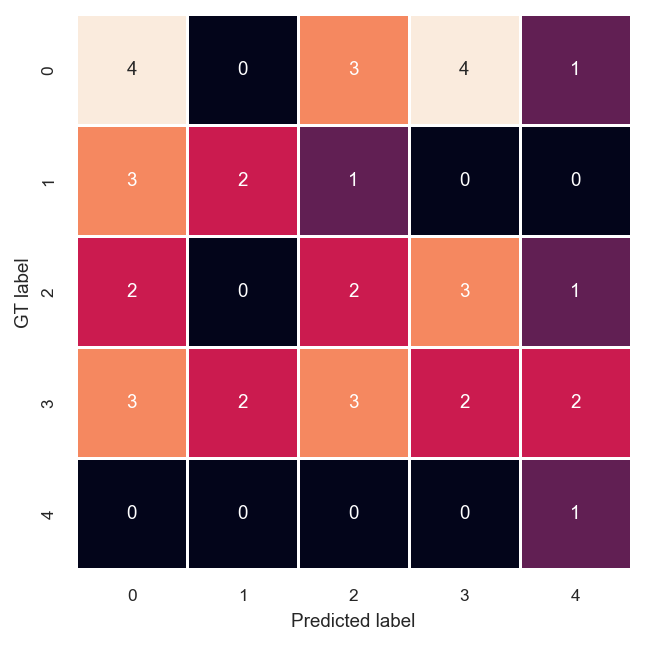

In [55]:
print("\nConfusion matrix (Testing):")
cm_tst = confusion_matrix(y_tst, y_tst_prd)
sns.set(font_scale=0.75)
sns.heatmap(cm_tst.T, square=True, annot=True, fmt='d',
  cbar=False, linewidths=0.5)
plt.ylabel('GT label')
plt.xlabel('Predicted label')